1. Data Preprocessing

In [1]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

2025-06-23 15:36:01.279967: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-06-23 15:36:01.577986: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-06-23 15:36:01.641908: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2025-06-23 15:36:01.641919: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if yo

In [120]:
# Data augmentation for training set
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=[0.8, 1.2],
    brightness_range=(0.8, 1.2),
    channel_shift_range=15,
    horizontal_flip=True,
    fill_mode='reflect'
)

# Only rescale for val/test
val_test_datagen = ImageDataGenerator(rescale=1./255)

# Create generators
train_generator = train_datagen.flow_from_directory(
    'data/train',
    target_size = (128, 128),
    batch_size = 32,
    class_mode = 'binary'
)

val_generator = val_test_datagen.flow_from_directory(
    'data/val',
    target_size = (128, 128),
    batch_size = 32,
    class_mode = 'binary'
)

test_generator = val_test_datagen.flow_from_directory(
    'data/test',
    target_size = (128, 128),
    batch_size = 32,
    class_mode = 'binary',
    shuffle = False # Important for evaluation
)

Found 800 images belonging to 2 classes.
Found 100 images belonging to 2 classes.
Found 100 images belonging to 2 classes.


2. Model Building

2.1 Option 1: Build model from scratch

In [87]:
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout, Dense, ReLU, Flatten, BatchNormalization
from tensorflow.keras import Input, Model

In [108]:
def convolutional_model(input_shape):
    inputs = Input(input_shape)

    # Block 1
    x = Conv2D(32, (3,3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2,2))(x)
    x = Dropout(0.25)(x)

    # Block 2
    x = Conv2D(64, (3,3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2,2))(x)
    x = Dropout(0.25)(x)

    # Block 3
    x = Conv2D(128, (3,3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2,2))(x)
    x = Dropout(0.25)(x)

    # Classification head
    x = Flatten()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)
    
    outputs = Dense(1, activation='sigmoid')(x)
    
    model = Model(inputs=inputs, outputs=outputs)
    return model

In [109]:
conv_model = convolutional_model((128, 128, 3))

conv_model.compile(
    loss='binary_crossentropy', 
    optimizer='adam',
    metrics=['accuracy']
)

conv_model.summary()

Model: "model_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_20 (InputLayer)       [(None, 128, 128, 3)]     0         
                                                                 
 conv2d_50 (Conv2D)          (None, 128, 128, 32)      896       
                                                                 
 max_pooling2d_49 (MaxPoolin  (None, 64, 64, 32)       0         
 g2D)                                                            
                                                                 
 dropout_27 (Dropout)        (None, 64, 64, 32)        0         
                                                                 
 conv2d_51 (Conv2D)          (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_50 (MaxPoolin  (None, 32, 32, 64)       0         
 g2D)                                                     

2.2 Option 2: Transfer learning from VGG16

In [121]:
# Transfer learning from VGG16
from tensorflow.keras.applications import VGG16

base_model = VGG16(weights='imagenet', 
                  include_top=False, 
                  input_shape=(128, 128, 3))

# Freeze convolutional layers
for layer in base_model.layers:
    layer.trainable = False

# Add custom head
x = GlobalAveragePooling2D()(base_model.output)
x = Dense(128, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)

outputs = Dense(1, activation='sigmoid')(x)

model = Model(base_model.input, outputs)

model.compile(loss='binary_crossentropy',
             optimizer='adam',
             metrics=['accuracy'])

model.summary()

Model: "model_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_22 (InputLayer)       [(None, 128, 128, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 128, 128, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 128, 128, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 64, 64, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 64, 64, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 64, 64, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 32, 32, 128)       0  

3. Model Training

In [90]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

In [122]:
callbacks = [
    EarlyStopping(
        monitor='val_accuracy',
        patience=5, 
        restore_best_weights=True,
        verbose=1
    ),
    ModelCheckpoint(
        'best_model.h5', 
        monitor='val_accuracy',
        save_best_only=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.5, 
        patience=2,
        min_lr=1e-6,
        verbose=1
    )
]

history = model.fit(
    train_generator,
    epochs=30,
    validation_data=val_generator,
    callbacks=callbacks
)

Epoch 1/30
25/25 [==============================] - ETA: 0s - loss: 0.3579 - accuracy: 0.8462
Epoch 1: val_accuracy improved from -inf to 0.63000, saving model to best_model.h5
25/25 [==============================] - 30s 1s/step - loss: 0.3579 - accuracy: 0.8462 - val_loss: 0.5214 - val_accuracy: 0.6300 - lr: 0.0010
Epoch 2/30
25/25 [==============================] - ETA: 0s - loss: 0.1486 - accuracy: 0.9388
Epoch 2: val_accuracy improved from 0.63000 to 0.86000, saving model to best_model.h5
25/25 [==============================] - 33s 1s/step - loss: 0.1486 - accuracy: 0.9388 - val_loss: 0.3158 - val_accuracy: 0.8600 - lr: 0.0010
Epoch 3/30
25/25 [==============================] - ETA: 0s - loss: 0.1338 - accuracy: 0.9450
Epoch 3: val_accuracy improved from 0.86000 to 0.96000, saving model to best_model.h5
25/25 [==============================] - 33s 1s/step - loss: 0.1338 - accuracy: 0.9450 - val_loss: 0.2315 - val_accuracy: 0.9600 - lr: 0.0010
Epoch 4/30
25/25 [===================

In [110]:
callbacks = [
    EarlyStopping(
        monitor='val_accuracy', 
        patience=5, 
        restore_best_weights=True,
        verbose=1
    ),
    ModelCheckpoint(
        'best_model_scratch.h5', 
        monitor='val_accuracy',
        save_best_only=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.5,
        patience=2,
        min_lr=1e-6,
        verbose=1
    )
]

history = conv_model.fit(
    train_generator, 
    epochs=30, 
    validation_data=val_generator,
    callbacks=callbacks
)

Epoch 1/30
25/25 [==============================] - ETA: 0s - loss: 0.8545 - accuracy: 0.4988
Epoch 1: val_accuracy improved from -inf to 0.50000, saving model to best_model_scratch.h5
25/25 [==============================] - 11s 416ms/step - loss: 0.8545 - accuracy: 0.4988 - val_loss: 0.6930 - val_accuracy: 0.5000 - lr: 0.0010
Epoch 2/30
25/25 [==============================] - ETA: 0s - loss: 0.6920 - accuracy: 0.5275
Epoch 2: val_accuracy did not improve from 0.50000
25/25 [==============================] - 10s 400ms/step - loss: 0.6920 - accuracy: 0.5275 - val_loss: 0.6908 - val_accuracy: 0.5000 - lr: 0.0010
Epoch 3/30
25/25 [==============================] - ETA: 0s - loss: 0.6784 - accuracy: 0.6037
Epoch 3: val_accuracy improved from 0.50000 to 0.57000, saving model to best_model_scratch.h5
25/25 [==============================] - 10s 408ms/step - loss: 0.6784 - accuracy: 0.6037 - val_loss: 0.6685 - val_accuracy: 0.5700 - lr: 0.0010
Epoch 4/30
25/25 [=============================

4. Model Evaluation

In [123]:
test_loss, test_acc = model.evaluate(test_generator)
print(f"Test Accuracy: {test_acc*100:.2f}%")

4/4 [==============================] - 3s 643ms/step - loss: 0.0831 - accuracy: 0.9900
Test Accuracy: 99.00%


In [111]:
test_loss, test_acc = conv_model.evaluate(test_generator)
print(f"Test Accuracy: {test_acc*100:.2f}%")

4/4 [==============================] - 1s 160ms/step - loss: 0.1235 - accuracy: 0.9500
Test Accuracy: 95.00%


In [130]:
from sklearn.metrics import confusion_matrix, roc_auc_score, roc_curve, classification_report

# Predict probabilities on test set
y_prob = conv_model.predict(test_generator)
y_pred = (y_prob > 0.5).astype(int)

# True labels
y_true = test_generator.classes

print(classification_report(y_true, y_pred))
cm = confusion_matrix(y_true, y_pred)
print("Confusion matrix:\n", cm)

auc = roc_auc_score(y_true, y_prob)
print("Test AUC:", auc)


4/4 [==============================] - 1s 139ms/step
              precision    recall  f1-score   support

           0       0.94      0.96      0.95        50
           1       0.96      0.94      0.95        50

    accuracy                           0.95       100
   macro avg       0.95      0.95      0.95       100
weighted avg       0.95      0.95      0.95       100

Confusion matrix:
 [[48  2]
 [ 3 47]]
Test AUC: 0.9907999999999999


In [101]:
import matplotlib.pyplot as plt

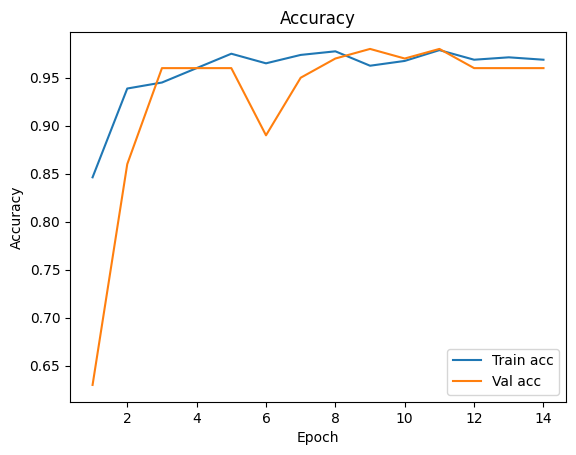

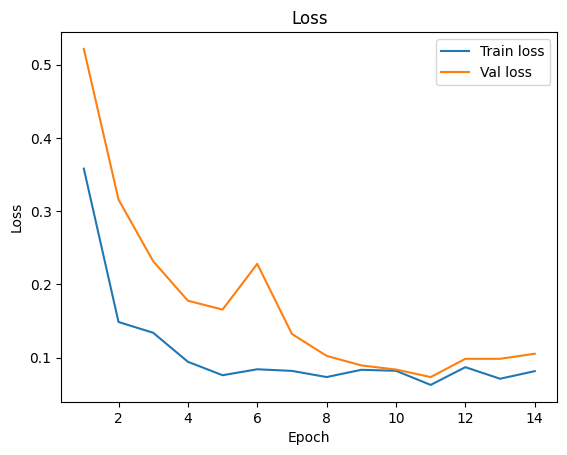

In [125]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)

plt.figure()
plt.plot(epochs, acc, label='Train acc')
plt.plot(epochs, val_acc, label='Val acc')
plt.title('Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()

plt.figure()
plt.plot(epochs, loss, label='Train loss')
plt.plot(epochs, val_loss, label='Val loss')
plt.title('Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()


5. Prediction on New Images

In [95]:
import os
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
import numpy as np

In [ ]:
def predict_and_display_test_set(test_dir, model, num_images):
    
    # Get all test image paths
    cat_dir = os.path.join(test_dir, 'cat')
    dog_dir = os.path.join(test_dir, 'dog')
    
    cat_images = [os.path.join(cat_dir, f) for f in os.listdir(cat_dir) 
                 if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    dog_images = [os.path.join(dog_dir, f) for f in os.listdir(dog_dir) 
                 if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    
    all_images = cat_images + dog_images
    if num_images is not None:
        all_images = all_images[:num_images]
    
    # Create figure
    cols = 5  # Number of columns in display
    rows = int(np.ceil(len(all_images) / cols))
    plt.figure(figsize=(20, 5*rows))
    
    for i, img_path in enumerate(all_images):
        # Load and predict
        img = image.load_img(img_path, target_size=(128, 128))
        x = image.img_to_array(img) / 255.0
        x = np.expand_dims(x, axis=0)
        
        pred = model.predict(x, verbose=0)[0][0]
        confidence = pred if pred > 0.5 else 1 - pred
        label = 'Dog' if pred > 0.5 else 'Cat'
        true_label = 'Dog' if 'dog' in img_path.lower() else 'Cat'
        
        # Plot
        plt.subplot(rows, cols, i+1)
        plt.imshow(img)
        plt.title(f"True: {true_label}\nPred: {label} ({confidence*100:.1f}%)", 
                 color='green' if label == true_label else 'red')
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

In [127]:
model = load_model('best_model.h5')

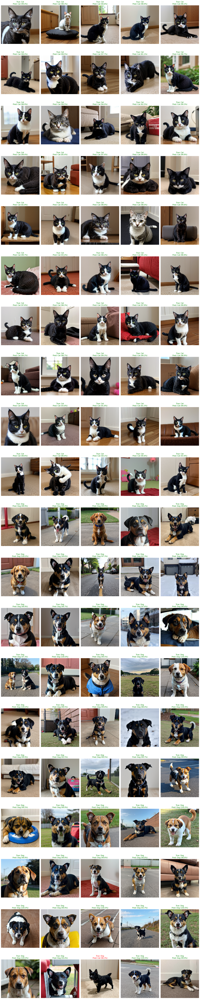

In [128]:
predict_and_display_test_set('data/test', model, num_images=100)

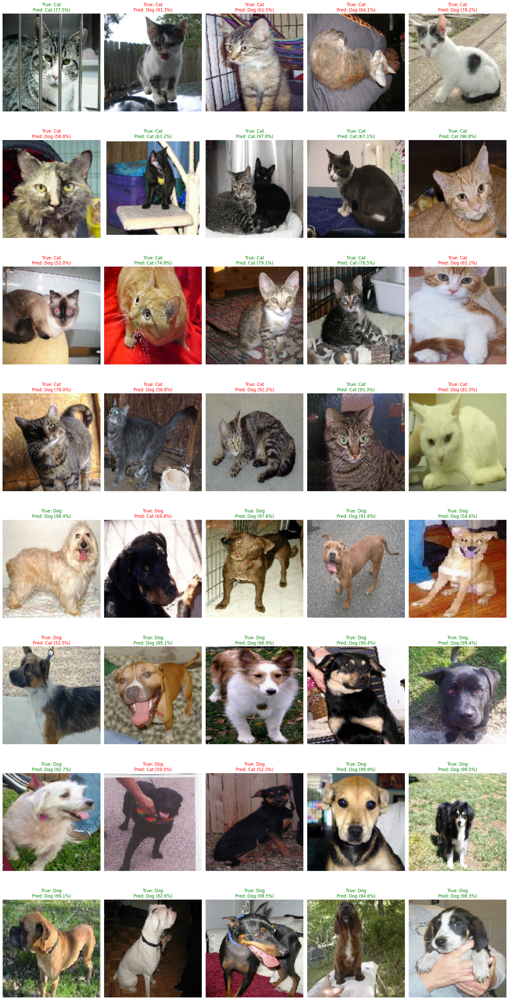

In [ ]:
predict_and_display_test_set('data/realworld_test', model, num_images=40)